In [60]:
import netCDF4 as nc
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.animation import FuncAnimation
from scipy.ndimage import convolve
from IPython.display import HTML
import glob
import os
import pandas as pd
from sklearn.metrics import roc_curve, auc
from neural_lam.models.hi_lam import RainfallHiLAM


In [75]:
def RainfallHiLAM(data_replaced, start_index):
    subset = data_replaced[start_index + 360 : start_index + 360 + 180]
    noise = np.random.uniform(0, 4, subset.shape)
    subset_with_noise = subset + subset * noise
    return subset_with_noise

In [2]:
file_path = './data_2018/rainfall_NW_2018_01.1/data.npy'

data = np.load(file_path)

print(np.shape(data))


(2880, 565, 784)


In [3]:
data

array([[[-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        ...,
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0]],

       [[-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        ...,
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0]],

       [[-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        ...,
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0]],

       ...,

       [[-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        [-1, -1, -1, ...,  0,  0,  0],
        ...,
        [-1, -1, -1, ...,  3,  4,  4],
        [-1, -1, -1, ...,  5,  4,  4],
        [-1, -1, -1, ...,  4,  4

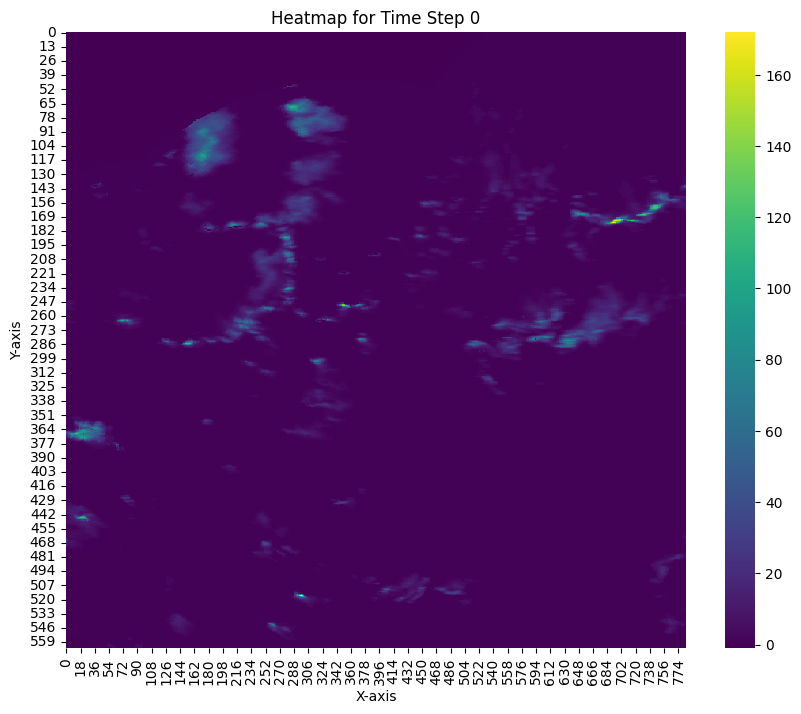

In [4]:
def statistics(array):
    stats = {
        'mean': np.mean(array),
        'median': np.median(array),
        'std_dev': np.std(array),
        'min': np.min(array),
        'max': np.max(array),
        'count_neg_1': np.sum(array == -1),
        'count_zero': np.sum(array == 0)
    }
    return stats

def visualize_heatmap(array, time_step):
    plt.figure(figsize=(10, 8))
    sns.heatmap(array[time_step], cmap='viridis')
    plt.title(f"Heatmap for Time Step {time_step}")
    plt.xlabel("X-axis")
    plt.ylabel("Y-axis")
    plt.show()

visualize_heatmap(data, 0)

In [5]:
statistics(data)

{'mean': 1.2680277454824112,
 'median': 0.0,
 'std_dev': 6.821902267648924,
 'min': -1,
 'max': 3405,
 'count_neg_1': 104003445,
 'count_zero': 1008675485}

In [6]:
def replace_neg1_with_surrounding_mean(data):
    data_copy = data.copy()
    kernel = np.array([[1, 1, 1], [1, 0, 1], [1, 1, 1]])

    for t in range(data_copy.shape[0]):
        neg1_mask = (data_copy[t] == -1)
        
        data_temp = data_copy[t].astype(float)
        data_temp[neg1_mask] = np.nan
        
        surrounding_sum = convolve(data_temp, kernel, mode='constant', cval=np.nan)
        
        valid_count = convolve(~np.isnan(data_temp), kernel, mode='constant', cval=0)
        
        valid_count[valid_count == 0] = np.nan
        
        surrounding_mean = surrounding_sum / valid_count
        
        data_copy[t][neg1_mask] = surrounding_mean[neg1_mask]
        
        if np.any(data_copy[t] == -1):
            global_mean = np.nanmean(data_copy[t])
            data_copy[t][data_copy[t] == -1] = global_mean

    return data_copy

In [7]:
data_replaced = replace_neg1_with_surrounding_mean(data)

/tmp/ipykernel_1738982/534975637.py:19: RuntimeWarning: invalid value encountered in cast
  data_copy[t][neg1_mask] = surrounding_mean[neg1_mask]


In [81]:
statistics(data_replaced)

{'mean': 1.3495594331943692,
 'median': 0.0,
 'std_dev': 6.80052159672129,
 'min': 0,
 'max': 3405,
 'count_neg_1': 0,
 'count_zero': 1112678851}

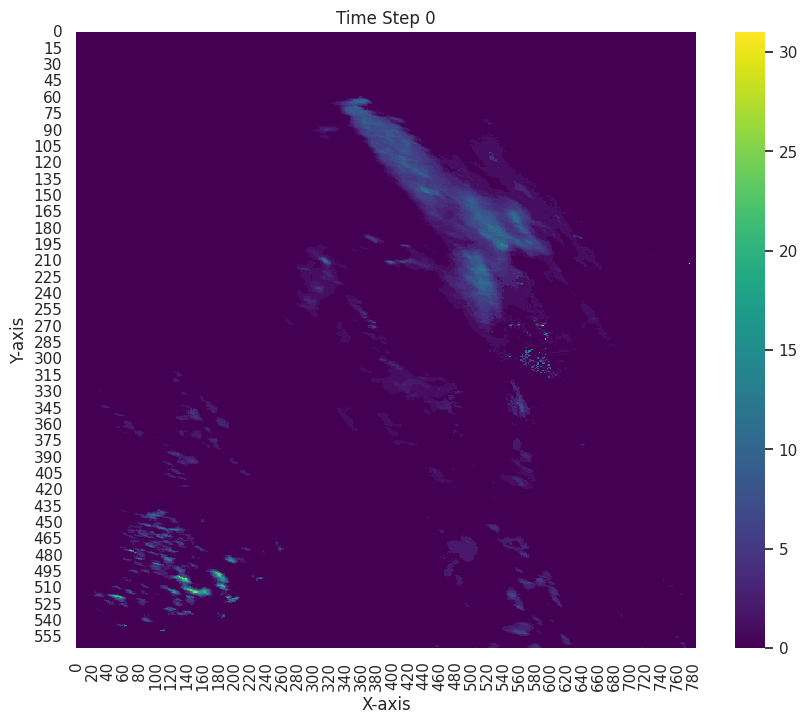

In [13]:
subset = data_replaced[370:550]

fig, ax = plt.subplots(figsize=(10, 8))
sns.set(style="whitegrid")

heatmap = sns.heatmap(subset[0], ax=ax, cmap='viridis', cbar=True)
cbar = heatmap.collections[0].colorbar
def update(frame):
    ax.clear()
    heatmap = sns.heatmap(subset[frame], ax=ax, cmap='viridis', cbar=False)
    ax.set_title(f"Time Step {frame}")
    ax.set_xlabel("X-axis")
    ax.set_ylabel("Y-axis")
    cbar.update_normal(heatmap.collections[0])

ani = FuncAnimation(fig, update, frames=range(subset.shape[0]), repeat=False)

HTML(ani.to_jshtml())

Animation size has reached 20983653 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


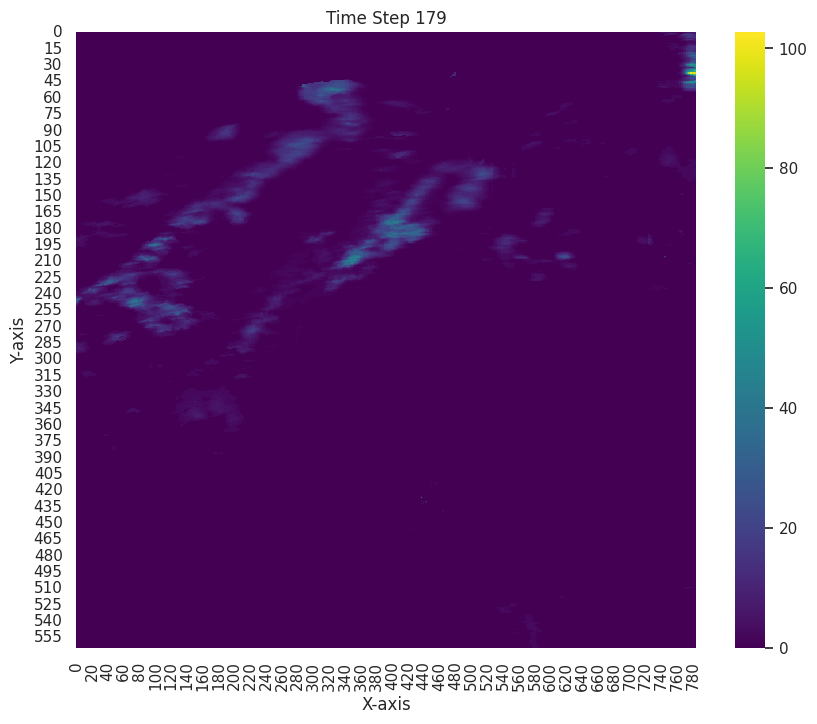

In [14]:
output = RainfallHiLAM(data_replaced, 10)
fig, ax = plt.subplots(figsize=(10, 8))
sns.set(style="whitegrid")

heatmap = sns.heatmap(output[0], ax=ax, cmap='viridis', cbar=True)
cbar = heatmap.collections[0].colorbar
def update(frame):
    ax.clear()
    heatmap = sns.heatmap(output[frame], ax=ax, cmap='viridis', cbar=False)
    ax.set_title(f"Time Step {frame}")
    ax.set_xlabel("X-axis")
    ax.set_ylabel("Y-axis")
    cbar.update_normal(heatmap.collections[0])
ani = FuncAnimation(fig, update, frames=range(output.shape[0]), repeat=False)

HTML(ani.to_jshtml())



In [66]:
output = HiLAM(data_replaced, 10)

In [67]:
def calculate_mape(original, predict):
    epsilon = 1e-10
    mape = np.mean(np.abs((original - predict) / (original + epsilon))) *100
    return mape

mape_result = calculate_mape(subset, output)
print("MAPE:", mape_result)

MAPE: 17.906491610324206


In [40]:
statistics(subset)

{'mean': 0.6392632643027713,
 'median': 0.0,
 'std_dev': 3.635077264332967,
 'min': 0,
 'max': 368,
 'count_neg_1': 0,
 'count_zero': 72593701}

In [68]:
def calculate_confusion_matrix_elements(original, predict, threshold):
    original_binary = (original > threshold).astype(int)
    predict_binary = (predict > threshold).astype(int)
    
    tp = np.sum((original_binary == 1) & (predict_binary == 1))
    tn = np.sum((original_binary == 0) & (predict_binary == 0))
    fp = np.sum((original_binary == 0) & (predict_binary == 1))
    fn = np.sum((original_binary == 1) & (predict_binary == 0))
    
    return tp, tn, fp, fn

threshold = 4.12 
tp, tn, fp, fn = calculate_confusion_matrix_elements(subset, output, threshold)

confusion_matrix = {
    'Predicted Positive': [tp, fp],
    'Predicted Negative': [fn, tn]
}
confusion_df = pd.DataFrame(confusion_matrix, index=['Actual Positive', 'Actual Negative'])

print(confusion_df)


                 Predicted Positive  Predicted Negative
Actual Positive             3342864                   0
Actual Negative             2572626            73817310


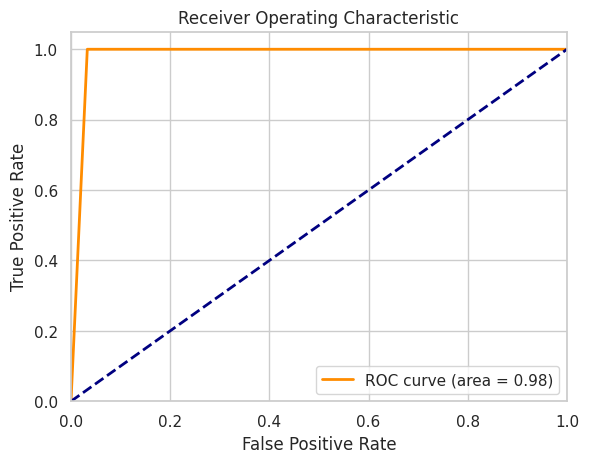

Threshold used for ROC curve: 4.239263264302771
                 Predicted Positive  Predicted Negative
Actual Positive             3342864                   0
Actual Negative             2509377            73880559


In [74]:
def calculate_confusion_matrix_elements(original, predict, threshold):
    """
    Tính toán TP, TN, FP, FN giữa hai ma trận với một ngưỡng cho trước.
    original: ma trận ban đầu (565, 784)
    predict: ma trận dự đoán (565, 784)
    threshold: ngưỡng để phân loại positive/negative
    """
    original_binary = (original > threshold).astype(int)
    predict_binary = (predict > threshold).astype(int)
    
    tp = np.sum((original_binary == 1) & (predict_binary == 1))
    tn = np.sum((original_binary == 0) & (predict_binary == 0))
    fp = np.sum((original_binary == 0) & (predict_binary == 1))
    fn = np.sum((original_binary == 1) & (predict_binary == 0))
    
    return tp, tn, fp, fn

def plot_roc_curve(tp, tn, fp, fn,threshold):
    total_positive = tp + fn
    total_negative = tn + fp

    y_true = np.concatenate([np.ones(total_positive), np.zeros(total_negative)])
    y_scores = np.concatenate([np.ones(tp), np.zeros(fn), np.ones(fp), np.zeros(tn)])

    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()

    print(f"Threshold used for ROC curve: {threshold}")
threshold = 4.2392632643027713
tp, tn, fp, fn = calculate_confusion_matrix_elements(subset, output, threshold)

plot_roc_curve(tp, tn, fp, fn, threshold)
confusion_matrix = {
    'Predicted Positive': [tp, fp],
    'Predicted Negative': [fn, tn]
}
confusion_df = pd.DataFrame(confusion_matrix, index=['Actual Positive', 'Actual Negative'])

print(confusion_df)